<a href="https://colab.research.google.com/github/marcelocl1363/marcelocl1363/blob/main/Fraude_VersionFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# <span style="color:MediumPurple"> Trabajo Práctico Final - Data mining: Fraud detection</span>


![](https://www.rklcpa.com/wp-content/uploads/2022/02/Data-analytics-for-fraud-detection-Featured-1125x546.png)


## <span style="color:MediumPurple"> Maestrandos:</span>
###  Aldana Louzan Grandi, Marcelo Letamendía, Martín Justo Ricci
***

## <span style="color:MediumPurple"> Índice</span>
1. [Instalaciones](#instalaciones)
2. [Librerías](#librerias)
3. [Introducción](#intro)
4. [Dataset Overview](#dataset)
5. [Análisis Exploratorio](#analisis)
    1. [Clientes](#seccion_4.1)
    2. [Importe](#seccion_4.2)
    3. [Tipo de Transacción](#seccion_4.3)
    4. [Fraude](#seccion_4.4)
    5. [Step](#seccion_4.5)
    6. [Correlación](#seccion_4.6)
6. [Fraude sub-dataset](#fraude_dataset)
7. [Feature Engineering](#feature_engineering)
    1. [Flag por día](#sección_6.1)
    2. [Importe cuenta origen vs Importe cuenta destino](#sección_6.2)
    3. [Flag importe](#sección_6.3)
8. [Pre-procesamient](#procesamiento)
    1. [Tipo de transacción](#seccion_7.1)
    2. [Fraude](#seccion_7.2)
9. [Correlación con el target: Fraude](#correlacion_fraude)
10. [Algoritmos de Clasificación](#algoritmo_clasificacion)
11. [Implementación del modelo: XGBoost (n=10)](#model)
    1. [Predicción](#prediccion)
12. [Otros algoritmos](#otros)
13. [Conclusión](#conclusion)
14. [Referencias](#referencias)

***

## <span style="color:MediumPurple" class="anchor" id="instalaciones"> Instalaciones</span>

In [1]:
!pip install plotly
!pip install xgboost

## <span style="color:MediumPurple" class="anchor" id="librerias"> Librerias</span>

In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
import math
import json
import os


import warnings
warnings.filterwarnings('ignore')

#Visualización
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.express as px
import plotly.graph_objects as go

#Features engeneering
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

#Modelos
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score,confusion_matrix,classification_report
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score,roc_auc_score, roc_curve, f1_score
import xgboost as xgb

#from sklearn import preprocessing
#from sklearn.model_selection import GridSearchCV
#from sklearn.neighbors import KNeighborsClassifier
#from sklearn.linear_model import LogisticRegression,SGDClassifier



## <span style="color:MediumPurple" class="anchor" id="intro"> Introducción </span>

El siguiente proyecto de minería de datos para la detección de fruades, se llevó a cabo utilizando una base de datos proporcionada ficticia, diseñada para simular transacciones y comportamientos fraudulentos.

Nuestro equipo ha aplicado técnicas de análisis exploratorio y modelos de clasificación para descubrir patrones y desarrollar un sistema de detección de fraudes.

## <span style="color:MediumPurple" class="anchor" id="dataset"> Dataset Overview</span>

### Data dictionary  <a class="anchor" id="dictionary"></a>

* **step:** mapa de unidades de tiempo. Un step es una hora. Total de steps 744 (30 días de simulación)
* **type:** CASH-IN (entrada de dinero, depósito), CASH-OUT (salida de dinero, extracción), DEBIT (Débito), PAYMENT (Pago) and TRANSFER (Transferencia)
* **amount:** monto de la transacción en moneda local
* **nameOrig:** cliente que realizó la transacción
* **oldbalanceOrg:** saldo antes de la transacción
* **newbalanceOrig:** saldo luego de la transacción
* **nameDest:** cliente receptor de la transacción (destinatario/beneficiario)
* **oldbalanceDest:** saldo inicial del destinatario antes de la transacción
* **newbalanceDest:** saldo final del destinatario luego de la transacción
* **isFraud:** marca que determina si la transacción fue fraudulente (1) o no fue fraudulenta (0)


In [3]:
#Si utiliza googleColab correr el siguiente codigo
from google.colab import drive
drive.mount("/content/drive")
df = pd.read_csv("/content/drive/MyDrive/MineriaU3U4U5TPfinal/Fraude.csv")

#Para cargar el dataset de forma local
#df= pd.read_csv('Fraude.csv')


Mounted at /content/drive


In [4]:
df.head()

,Unnamed: 0,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,isFlaggedFraud
0,5003937,353,CASH_OUT,366837.00,C1378361187,0.0,0.0,C971468434,421675.19,558423.14,0,0
1,5003938,353,CASH_OUT,227225.22,C211071968,0.0,0.0,C1048278624,447213.34,674438.56,0,0
2,5003939,353,CASH_OUT,92507.74,C2120887021,0.0,0.0,C672681554,214510.10,307017.84,0,0
3,5003940,353,CASH_OUT,162519.57,C1103264078,0.0,0.0,C532824402,844653.01,1007172.59,0,0
4,5003941,353,CASH_OUT,157257.18,C1401140498,0.0,0.0,C700036764,2326697.36,2483954.55,0,0


Podemos observar que la variable que contiene el id no tiene nombre, por lo que decidimos nombrarla como id. Al mismo tiempo decidimos eliminar la columna isFlaggedFraud.

In [5]:
df.rename( columns={'Unnamed: 0':'id'}, inplace=True )

In [6]:
df.drop(['isFlaggedFraud'], axis='columns', inplace=True)

Podemos observar que nuestro dataset contiene 11 variables y 1362621 entradas

In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1362621 entries, 0 to 1362620
Data columns (total 11 columns):
 #   Column          Non-Null Count    Dtype  
---  ------          --------------    -----  
 0   id              1362621 non-null  int64  
 1   step            1362621 non-null  int64  
 2   type            1362621 non-null  object 
 3   amount          1362621 non-null  float64
 4   nameOrig        1362621 non-null  object 
 5   oldbalanceOrg   1362621 non-null  float64
 6   newbalanceOrig  1362621 non-null  float64
 7   nameDest        1362621 non-null  object 
 8   oldbalanceDest  1362621 non-null  float64
 9   newbalanceDest  1362621 non-null  float64
 10  isFraud         1362621 non-null  int64  
dtypes: float64(5), int64(3), object(3)
memory usage: 114.4+ MB


El dataset no cuenta con valores nulos

In [8]:
df.isnull().sum()

id                0
step              0
type              0
amount            0
nameOrig          0
oldbalanceOrg     0
newbalanceOrig    0
nameDest          0
oldbalanceDest    0
newbalanceDest    0
isFraud           0
dtype: int64

Con la siguiente función obtuvimos estadística descriptiva de las variables numéricas. Observando los extremos y los cuartiles de las variables podemos deducir que algunas variables tienen outliers tanto superiores como inferiores.

In [9]:
df.describe()

,id,step,amount,oldbalanceOrg,newbalanceOrig,oldbalanceDest,newbalanceDest,isFraud
count,1.362621e+06,1.362621e+06,1.362621e+06,1.362621e+06,1.362621e+06,1.362621e+06,1.362621e+06,1.362621e+06
mean,5.673367e+06,4.332181e+02,1.778079e+05,8.036913e+05,8.187242e+05,1.223466e+06,1.326195e+06,6.027355e-03
std,4.393708e+05,9.546084e+01,4.484508e+05,2.758981e+06,2.787910e+06,4.256899e+06,4.333741e+06,7.740174e-02
min,3.000000e+00,1.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
25%,5.340655e+06,3.740000e+02,1.390873e+04,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
50%,5.681310e+06,3.970000e+02,7.270051e+04,1.484949e+04,0.000000e+00,1.194589e+05,1.983316e+05,0.000000e+00
75%,6.021965e+06,4.690000e+02,2.053803e+05,1.064960e+05,1.364784e+05,9.316985e+05,1.084968e+06,0.000000e+00
max,6.362620e+06,7.430000e+02,1.995378e+07,5.958504e+07,4.958504e+07,3.560159e+08,3.561793e+08,1.000000e+00


## <span style="color:MediumPurple" class="anchor" id="analisis"> Análisis exploratorio</span>

Dado que nuestro dataset contiene un alto número de entries, decidimos generar una muestra aleatoria y representativa de nuestro dataset para realizar el análisis exploratorio.

Para grandes poblaciones, con mas de 10K entries, el porcentaje mínimo para la muestra es de 10% [**[1]**](#referencias) decidimos generar una muestra del 15%.


In [10]:
sample_df = df.sample(frac=0.15)
sample_df.head()

,id,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud
1227074,6233625,594,CASH_IN,58644.32,C2046830035,11687983.5,11746627.83,C450205200,1427780.42,1369136.09,0
754760,5759221,400,PAYMENT,9785.59,C120130891,21342.0,11556.41,M667493938,0.00,0.00,0
750654,5755115,399,TRANSFER,1748487.05,C1764242530,42929.0,0.00,C715837950,3292860.17,5041347.22,0
218093,5222230,370,CASH_OUT,34065.13,C918666528,0.0,0.00,C634913733,145247.75,179312.88,0
891334,5895853,403,CASH_OUT,115826.78,C1562654696,0.0,0.00,C1951103089,155196.82,271023.59,0


### Clientes <a class="anchor" id="seccion_4.1"></a>

Basándonos en la última muestra aleatorea generada se puede ver que el máximo de transacciones que los mismos clientes realizaron son dos, habiendo sólo 11 clientes que realizaron dos transacciones.

Sin embargo no son estos clientes los que realizaron transacciones de mayor valor.

Analizamos esos clientes en el dataset original, pudimos observar que el tipo de transacciones que realizaron son las siguientes (de la mas frecuente a la menos frecuente):
* Pago
* Transferencia
* Extracción y Depósito

El rango de cantidad de dinero va de 144794.01 a 2.199.793.63.

Este último importe, corresponde al único cliente al cual se encontró una transacción fraudulenta con tipo de trasacción = Transferencia.

Es importante destacar, que habiendo llevado a cabo este mismo análisis a distintas muestras, en todas ellas podemos ver que la mayor cantidad de transacciones que el mismo cliente realiza es 2. Y que son muy pocos los casos (menor a 2) en los que estas transacciones fueron detectadas como fraudulentas. Pero, generalmente este tipo de transacción es en la que más dinero interviene.

In [11]:
sample_df['nameOrig'].value_counts()

C946284701     2
C1311441257    2
C272559797     2
C1808684941    2
C243517572     2
              ..
C1015876936    1
C884531873     1
C388232964     1
C1642325378    1
C1292733159    1
Name: nameOrig, Length: 204385, dtype: int64

In [12]:
sample_df['nameOrig'].mode()

0    C1247162170
1    C1311441257
2    C1808684941
3    C1846905070
4    C1962833910
5     C243517572
6     C272559797
7     C946284701
Name: nameOrig, dtype: object

In [13]:
df[df['nameOrig'] == 'C1141768549'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount              144794.01
id                          2
type       [CASH_IN, PAYMENT]
isFraud                   [0]
dtype: object

In [14]:
df[df['nameOrig'] == 'C1277258446'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount              182133.84
id                          2
type       [PAYMENT, CASH_IN]
isFraud                   [0]
dtype: object

In [15]:
df[df['nameOrig'] == 'C1612787265'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount               269154.13
id                           2
type       [PAYMENT, CASH_OUT]
isFraud                    [0]
dtype: object

In [16]:
df[df['nameOrig'] == 'C635739031'].agg(
    {
        # cantidad total en las transacciones
        'amount': ['unique','sum'],
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

,amount,id,type,isFraud
unique,"[234007.52, 1965786.11]",NaN,"[CASH_OUT, TRANSFER]","[0, 1]"
sum,2199793.63,NaN,NaN,NaN
count,NaN,2.0,NaN,NaN


In [17]:
df[df['nameOrig'] == 'C1840140585'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount               35350.41
id                          2
type       [CASH_IN, PAYMENT]
isFraud                   [0]
dtype: object

In [18]:
df[df['nameOrig'] == 'C257532451'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount              284066.14
id                          2
type       [PAYMENT, CASH_IN]
isFraud                   [0]
dtype: object

In [19]:
df[df['nameOrig'] == 'C750476725'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount      35177.17
id                 2
type       [PAYMENT]
isFraud          [0]
dtype: object

In [20]:
df[df['nameOrig'] == 'C848183882'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #tipo de transaccion
        'type':'unique',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount               237720.66
id                           2
type       [CASH_OUT, PAYMENT]
isFraud                    [0]
dtype: object

In [21]:
df_origen = sample_df.groupby("nameOrig")["amount"].sum().nlargest(15)
df_origen

nameOrig
C2104950363    16988967.91
C1161085118    16475933.00
C379931666     13922066.62
C1699785789    13692161.89
C1910098081    12543280.35
C79371699      12310042.35
C606200032     12175598.95
C37092198      10848128.05
C1189668033    10218694.29
C1490613220    10131846.95
C1074619527    10000000.00
C1079335762    10000000.00
C1096385925    10000000.00
C1110953726    10000000.00
C1111699947    10000000.00
Name: amount, dtype: float64

Basándonos en la última muestra aleatoria generada podemos observar que existen 5 clientes receptores que se encontraron vinculados a una mayor cantidad de transferencias (5). Otros tres clientes receptores se encontraron vinculados a 4 transferencias. Mientras que el resto solo se encontró vinculado con una única transferencia.

Cabe destacar que ninguno de estos clientes receptores, son aquellos que recibieron mayores sumas de dinero.

Analizando esos clientes en el dataset original, pudimos observar que el rango de cantidad de dinero va de 1603614.64
a 4.058.356,20.

Este último importe el cual es el mayor, corresponde al único cliente al cual se encontró una transacción fraudulenta. Pudimos ver que el cliente de origen de estas transacciones no esta involucrado en transacciones fraudulentas.

Al mismo tiempo estas transacciones se dieron con distintos clientes de origen.

Es importante destacar, que habiendo llevado a cabo este mismo análisis a distintas muestras, en todas ellas podemos ver que la mayor cantidad de transacciones que un mismo cliente recibe varia entre 5 a un maximo de 11. Y que son muy pocos los casos (menor a 2) en los que estas transacciones fueron detectadas como fraudulentas. Pero, generalmente este tipo de transacción es en la que más dinero interviene.

In [22]:
receptores = sample_df['nameDest'].value_counts()
receptores

C1842906563    5
C180795141     5
C91525685      5
C933921266     5
C1714617051    5
              ..
M1235394887    1
M731515961     1
M1877935915    1
C126126725     1
C695650666     1
Name: nameDest, Length: 188749, dtype: int64

In [23]:
sample_df['nameDest'].mode()

0    C1214943629
1    C1714617051
2    C1729259817
3     C180795141
4    C1842906563
5    C1947527507
6     C347455049
7      C91525685
8     C933921266
Name: nameDest, dtype: object

In [24]:
df[df['nameDest'] == 'C1640532000'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #cuenta de origen
        'nameOrig':'count',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount      4830539.47
id                   5
nameOrig             5
isFraud            [0]
dtype: object

In [25]:
df[df['nameDest'] == 'C1831836587'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #cuenta de origen
        'nameOrig':'count',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount      4321063.37
id                   6
nameOrig             6
isFraud            [0]
dtype: object

In [26]:
df[df['nameDest'] == 'C309078889'].agg(
    {
        # cantidad total en las transacciones
        'amount': ['sum','unique'],
        # cantidad de transacciones
        'id': "count",
        #cuenta de origen
        'nameOrig':['count','unique'],
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

,amount,id,nameOrig,isFraud
sum,1955163.61,NaN,NaN,NaN
unique,"[58110.38, 379359.68, 121508.38, 218643.68, 15...",NaN,"[C1157751181, C1531277985, C1494787474, C13278...","[0, 1]"
count,NaN,7.0,7,NaN


In [27]:
df[df['nameDest'] == 'C401203546'].agg(
    {
        # cantidad total en las transacciones
        'amount': 'sum',
        # cantidad de transacciones
        'id': "count",
        #cuenta de origen
        'nameOrig':'count',
        #chequear si tuvieron transacciones fraudulentas
        'isFraud':'unique'
    }
)

amount      1603614.64
id                   7
nameOrig             7
isFraud            [0]
dtype: object

In [28]:
df_destino = sample_df.groupby("nameDest")["amount"].sum().nlargest(10)
df_destino

nameDest
C1105901057    16988967.91
C862954505     16475933.00
C1729335986    15599497.20
C1201081149    14232990.27
C407325956     13922066.62
C576011793     13743796.92
C1153577641    12434608.52
C662784343     12338141.94
C1986037639    11294534.89
C1466716052    10848128.05
Name: amount, dtype: float64

### Importe <a class="anchor" id="seccion_4.2"></a>

Como mencionamos anteriormente algunas variables se encuentran sesgadas. Una de ellas es el importe (Amount), pudiendo encontrar varios outiliers tanto superiores como inferiores.
Esta variable se encuentra sesgada hacia la derecha, encontrandose la mayoría de los outliers en el quartil superior.

Consideramos que los outiliers en esta variable representan data significativa, por lo que decidimos no descartarlos en nuestro análisis.

In [29]:
#Función para obtener los outliers
def find_outliers_IQR(df):

   q1=df.quantile(0.25)

   q3=df.quantile(0.75)

   IQR=q3-q1

   outliers = df[((df<(q1-1.5*IQR)) | (df>(q3+1.5*IQR)))]

   return outliers

In [30]:
outliersAmount = find_outliers_IQR(sample_df['amount'])

print('Número de outliers: '+ str(len(outliersAmount)))

print('Outlier máximo: '+ str(outliersAmount.max()))

print('Outiler mínimo: '+ str(outliersAmount.min()))

Número de outliers: 11353
Outlier máximo: 16988967.91
Outiler mínimo: 493611.16


In [31]:
fig = px.box(sample_df, y="amount")
fig.show()

En el siguiente gáfico podemos observar como el importe tiene mayor cantidad de outilers en aquellas transacciones que representan:
* Salida de dinero - Extracción
* Transferencia

Siendo transferencia la que representan importes más elevados.

In [32]:
fig = px.box(df, x="type", y="amount")
fig.show()

### Tipo de Transacción <a class="anchor" id="seccion_4.3"></a>

Continuando con el análisis del tipo de transacción, podemos ver que así como Extracción y Transferencia son aquellas que poseen más cantidad de outliers superiores, son también el único tipo de transacción que fue detectado como fraudulenta.

También podemos observar, que en extracción fueron las transacciones fraudulentas las que estaban involucradas en mayores cantidades de dinero, mientras que en transferencia es lo opuesto.

Es interesante observar que al mismo tiempo Transferencia es una de las transacciones menos frecuentes. Pero Extracciones es de las más frecuente.

Tambien podemos destacar que el rango de las trassancciones fraudulentas es similar para ambos tipos de transaccion.

In [33]:
sample_df['type'].value_counts()

CASH_OUT    70222
PAYMENT     69835
CASH_IN     45114
TRANSFER    17790
DEBIT        1432
Name: type, dtype: int64

In [34]:
fig = px.box(sample_df, x="type", y='amount',color="isFraud")
fig.update_traces()
fig.show()

### Fraude <a class="anchor" id="seccion_4.4"></a>

Podemos observar que la variable Fraude se encuentra desbalanceada, ya que las transacciones no fraudulentas representan solo un 0.6% de todo el dataset.

Por otro lado si comparamos el importe de las transacciones fraudulentas vs las nos fraudulentas podemos observar, que proporcionalmente las fraudulentas representan un mayor importe.

In [35]:
sample_df['isFraud'].value_counts()

0    203091
1      1302
Name: isFraud, dtype: int64

In [36]:
fig = go.Figure(data=[go.Pie(labels=['No Fraude','Fraude'], values=sample_df['isFraud'].value_counts())])
fig.show()

In [37]:
df_groups = sample_df.groupby('isFraud')['amount'].sum()
df_groups

isFraud
0    3.449475e+10
1    1.929233e+09
Name: amount, dtype: float64

In [38]:
fig = px.histogram(sample_df, x="amount",histnorm='percent' , color="isFraud")
fig.show()

In [39]:
sample_df[sample_df['isFraud'] == 1].agg(
    {
        # cantidad total en las transacciones
        'amount': 'mean',
        #tipo de transaccion
        'type':'unique',
    }
)

amount          1481745.591912
type      [TRANSFER, CASH_OUT]
dtype: object

In [40]:
fig = px.scatter(sample_df.query("isFraud==1"), x="amount", y="oldbalanceOrg", size="step", color="type", hover_name='newbalanceOrig', log_x=True, size_max=60)
fig.show()

### Step <a class="anchor" id="seccion_4.5"></a>

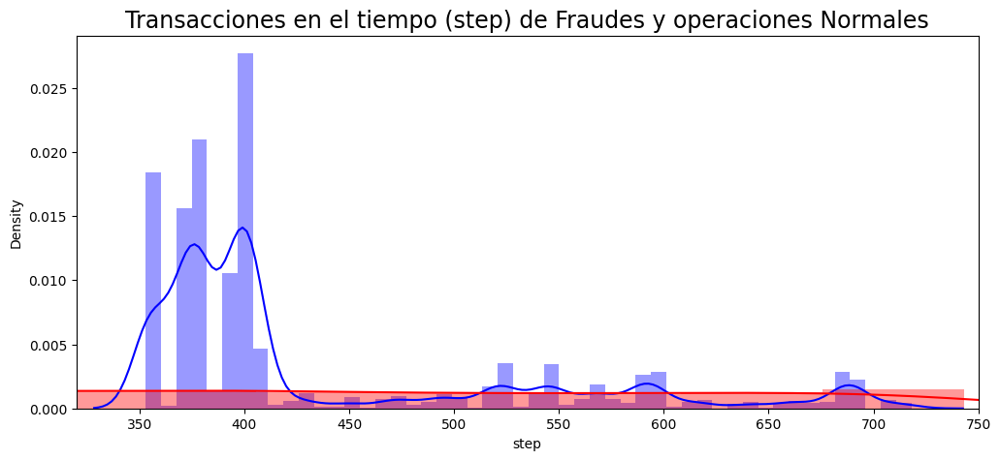

In [41]:
plt.figure(figsize=(12,5))
sns.distplot(sample_df[sample_df['isFraud'] == 0]["step"], color='blue')
sns.distplot(sample_df[sample_df['isFraud'] == 1]["step"], color='red')
plt.title('Transacciones en el tiempo (step) de Fraudes y operaciones Normales', fontsize=17)
plt.xlim([320,750])
plt.show()

Con el siguiente gráfico se puede observar que las transacciones de Cash_in, Payment y Debit comienzan a realizarse luego del step 353. Mientras que las transacciones de Cash_out y Transfer comienzan desde step = 0.

Por otro lado si analizamos la primera parte de este gráfico antes del step 353, podemos ver que la todas las transacciones son fraudulentas, esta información se puede ver en el gráfico posicionándose sobre los puntos.

In [42]:
fig = px.scatter(sample_df, x="step", y="amount", color="type", hover_name = 'isFraud',
           marginal_x="box", template="simple_white")
fig.show()

Con el siguiente código se puede comprobar que anterior a 353 steps (dia 15), las únicas transacciones que se realizaron fueron fraudulentas.

In [43]:
sample_df[sample_df['step'] < 353].agg(
    {
        # cantidad total en las transacciones
        'isFraud': ['unique', 'count'],
        'id':'count'
    }
)

,isFraud,id
unique,[1],NaN
count,641,641.0


In [44]:
sample_df[sample_df['step'] >= 353].agg(
    {
        # cantidad total en las transacciones
        'isFraud': ['unique', 'count'],
        'id':'count'
    }
)

,isFraud,id
unique,"[0, 1]",NaN
count,203752,203752.0


### Correlación <a class="anchor" id="seccion_4.6"></a>

Podemos ver que la única variable que tiene una correlación positiva moderada con la variable "isFraud" es "amount".

Existe una correlación fuerte positiva entre las variables "newbalanceDest" and "oldbalanceDest" lo que es lógico.


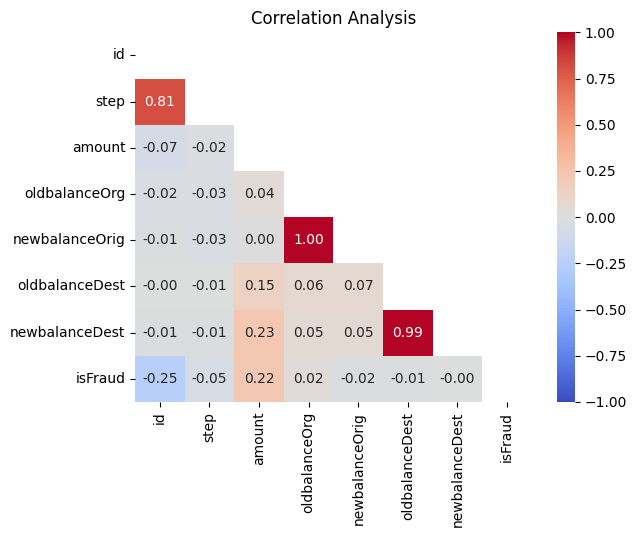

In [45]:
corr = df.corr()
mask = np.triu(np.ones_like(corr,dtype = bool))

plt.figure(dpi=100)
plt.title('Correlation Analysis')
sns.heatmap(corr,mask=mask,annot=True,lw=0,linecolor='black',cmap='coolwarm',fmt = "0.2f", vmin=-1, vmax=1)
plt.xticks(rotation=90)
plt.yticks(rotation = 0)
plt.show()

## <span style="color:MediumPurple" class="anchor" id="feature_engineering">Feature engineering</span>

<div class="alert alert-block alert-danger">
<b>Nota:</b> En esta seccion decidimos agregar distintas variables para flaggear transacciones que pueden ser fraudulentas.</div>
<div class="alert alert-block alert-danger">
<b>Flag por día: </b> Crear un flag aquellas transacciones que se dan antes del dia 15
<b>Flag por balance:</b> Crear un flag en aquellas transacciones donde el balance de la transaccion no concuerda
<b>Flag importe:</b> Crear un flag en aquellas transacciones que involucran un importe sospechoso



In [46]:
df_copy = df.copy()

### Flag por dia <a class="anchor" id="seccion_6.1"></a>

En base a lo encontrado en el análisis exploratorio sabemos que las transacciones fraudulentas se realizaron mayormente antes del dia 15.  Por lo que vamos a realizar un Flag para este tipo de transacciones


In [47]:
# crear nueva columna dia
df_copy['dia'] = 0
# Dividir los step en 24 para calcular el dia. Usamos .ceil para redondear
df_copy.loc[df_copy['step']>0, 'dia'] = np.ceil(df_copy['step']/24)
df_copy

,id,step,type,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,dia
0,5003937,353,CASH_OUT,366837.00,C1378361187,0.00,0.0,C971468434,421675.19,558423.14,0,15.0
1,5003938,353,CASH_OUT,227225.22,C211071968,0.00,0.0,C1048278624,447213.34,674438.56,0,15.0
2,5003939,353,CASH_OUT,92507.74,C2120887021,0.00,0.0,C672681554,214510.10,307017.84,0,15.0
3,5003940,353,CASH_OUT,162519.57,C1103264078,0.00,0.0,C532824402,844653.01,1007172.59,0,15.0
4,5003941,353,CASH_OUT,157257.18,C1401140498,0.00,0.0,C700036764,2326697.36,2483954.55,0,15.0
...,...,...,...,...,...,...,...,...,...,...,...,...
1362616,6362616,743,CASH_OUT,339682.13,C786484425,339682.13,0.0,C776919290,0.00,339682.13,1,31.0
1362617,6362617,743,TRANSFER,6311409.28,C1529008245,6311409.28,0.0,C1881841831,0.00,0.00,1,31.0
1362618,6362618,743,CASH_OUT,6311409.28,C1162922333,6311409.28,0.0,C1365125890,68488.84,6379898.11,1,31.0
1362619,6362619,743,TRANSFER,850002.52,C1685995037,850002.52,0.0,C2080388513,0.00,0.00,1,31.0


In [48]:
df_copy['dia'].mode()

0    17.0
Name: dia, dtype: float64

In [49]:
# Crear una nueva columna flag_Dia
df_copy['flag_Dia'] = 0
# Flaggear todas las transacciones que se dan antes del dia 15
df_copy.loc[(df_copy['dia'] < 15), 'flag_Dia'] = 1

### Importe cuenta origen vs Importe cuenta destino <a class="anchor" id="seccion_6.2"></a>

Agregaremos una columna que nos permita fácilmente distinguir si el balance de la cuenta de origen con la cuenta de destino es consistente.

In [50]:
# Crear una nueva columna flag_balance
df_copy['flag_Balance'] = 0
# Cash_out: newbalanceOrg < oldbalanceOrg
df_copy.loc[(df_copy['newbalanceOrig']-df_copy['oldbalanceOrg'] < 0) & (df_copy['type']=='CASH_OUT'), 'flag_Balance'] = 1
# Transfer: oldbalanceDest < newbalanceDest
df_copy.loc[(df_copy['oldbalanceDest']-df_copy['newbalanceDest'] < 0) &(df_copy['type']=='TRANSFER'), 'flag_Balance'] = 1


### Flag Importe <a class="anchor" id="seccion_6.3"></a>

Analizamos por cuartiles, el importe de transacciones fraudulentas, y vamos a utilizar el cuartil que mas importe representa para flaggear esas transacciones

In [51]:
df_copy.loc[(df_copy['isFraud'] == 1) & (df_copy['amount']>df_copy['amount'].min()) & (df_copy['amount']<df_copy['amount'].quantile(0.25)), 'isFraud'].count()


330

In [52]:
df_copy.loc[(df_copy['isFraud'] == 1) & (df_copy['amount']>df_copy['amount'].quantile(0.25)) & (df_copy['amount']<df_copy['amount'].quantile(0.5)), 'isFraud'].count()

1016

In [53]:
df_copy.loc[(df_copy['isFraud'] == 1) & (df_copy['amount']>df_copy['amount'].quantile(0.5)) & (df_copy['amount']<df_copy['amount'].quantile(0.75)), 'isFraud'].count()

1431

In [54]:
df_copy.loc[(df_copy['isFraud'] == 1) & (df_copy['amount']>df_copy['amount'].quantile(0.75)) & (df_copy['amount']<df_copy['amount'].max()), 'isFraud'].count()

5420

Como podemos observar el la mayor cantidad de transacciones fraudulentas con el mayor importe se realizan en el cuarto cuartil.

In [55]:
df_copy['amount'].describe()

count    1.362621e+06
mean     1.778079e+05
std      4.484508e+05
min      0.000000e+00
25%      1.390873e+04
50%      7.270051e+04
75%      2.053803e+05
max      1.995378e+07
Name: amount, dtype: float64

In [56]:
df_copy['flag_Importe'] = 0
df_copy.loc[(df_copy['amount'] > df_copy['amount'].quantile(0.75)), 'flag_Importe'] = 1

## <span style="color:MediumPurple" class="anchor" id="procesamiento">Pre-procesamiento</span>

### Tipo de transacción <a class="anchor" id="seccion_7.1"></a>


Debido a que la variable "type" no es una variable ordinal, es decir que no queremos asignar un peso numérico a cada valor de esta variable, decidimos utiilzar "One hot encoding" para trabajar con esta variable

In [57]:
df_copy=pd.concat([df_copy,pd.get_dummies(df_copy['type'], prefix='type_')],axis=1)
df_copy.drop(['type'],axis=1,inplace = True)


In [58]:
df_copy.head()

,id,step,amount,nameOrig,oldbalanceOrg,newbalanceOrig,nameDest,oldbalanceDest,newbalanceDest,isFraud,dia,flag_Dia,flag_Balance,flag_Importe,type__CASH_IN,type__CASH_OUT,type__DEBIT,type__PAYMENT,type__TRANSFER
0,5003937,353,366837.00,C1378361187,0.0,0.0,C971468434,421675.19,558423.14,0,15.0,0,0,1,0,1,0,0,0
1,5003938,353,227225.22,C211071968,0.0,0.0,C1048278624,447213.34,674438.56,0,15.0,0,0,1,0,1,0,0,0
2,5003939,353,92507.74,C2120887021,0.0,0.0,C672681554,214510.10,307017.84,0,15.0,0,0,0,0,1,0,0,0
3,5003940,353,162519.57,C1103264078,0.0,0.0,C532824402,844653.01,1007172.59,0,15.0,0,0,0,0,1,0,0,0
4,5003941,353,157257.18,C1401140498,0.0,0.0,C700036764,2326697.36,2483954.55,0,15.0,0,0,0,0,1,0,0,0


### Fraude <a class="anchor" id="seccion_7.2"></a>

Como mencionamos anteriormente la variable fraude esta desbalanceada, por lo que podríamos balancearla.

Pensamos en utilizar el método Synthetic Minority Oversampling Technique. Este método genera nueva data basada en implicaciones de la data previa. En lugar de eliminar o copiar datos, como sucede en otros métodos, se usa los valores originales para generar nueva data [**[2]**](#referencias).

Este tipo de método se utiliza en casos de que la clase minoritaria (fraude) tiene una cantidad muy limitada y baja de instancias.

Utilizar estos métodos poseen ciertas desventajas, como que al generar estas muestras existe riesgo de introducir información falsa o ruido al conjunto, obteniendo modelos sensibles a datos atípicos.

Al mismo tiempo, al utilizar modelos de clasificación como árboles de decisión que utilizan un algoritmo greedy, podemos caer en el problema de overfitting, por lo que finalmente decidimos no balancear nuestro dataset.

Por lo que el código en la siguiente celda debe ser comentado

In [59]:
# Sacamos el codigo que balancea la muestra
#Getting the max size
#max_size = df_copy['isFraud'].value_counts().max()

#Balancing the target label
#lst = [df_copy]
#for class_index, group in df_copy.groupby('isFraud'):
#    lst.append(group.sample(max_size-len(group), replace=True))
#df_copy = pd.concat(lst)

In [60]:
#df_copy['isFraud'].value_counts()

## <span style="color:MediumPurple" class="anchor" id="correlacion_fraude">Correlación con el target: Fraude</span>

Luego de realizar el procesamiento de datos y feature engineering, analizamos nuevamente la correlación de todas nuestras variables con la variable target (isFraud).

Podemos observar que las variables que se encuentran correlacionadas positivamente son:

* flag_Día
* amount
* type_TRANSFER
* flag_Importe
* flag_Balance
* type_CASH_OUT
* oldbalanceOrg

El resto de las variables se encuentran correlacionadas negativamente.

Es importante destacar que la unica variable que tiene una correlación moderada es flag_Día.
Es interesante destacar que aunque step, sea una variable decisiva a la hora de detectar una transacción fraudulenta, esta tiene una correlación débil negativa con la variable fraude. Como mencionamos en nuestro análisis exploratorio, aunque todas las transacciones previas al step 353 son fraudulentas, a partir de este punto de inflexión se encuentran transacciones de ambos tipos, sin haber posiblemente una correlación entre esta variable.

In [61]:
correlation_matrix = df_copy.corr()
correlation_matrix['isFraud'].sort_values(ascending=False)

isFraud           1.000000
flag_Dia          0.676138
amount            0.224029
type__TRANSFER    0.113402
flag_Importe      0.073720
flag_Balance      0.038773
type__CASH_OUT    0.025957
oldbalanceOrg     0.023877
newbalanceDest   -0.000835
type__DEBIT      -0.006605
oldbalanceDest   -0.012425
newbalanceOrig   -0.017495
type__CASH_IN    -0.041490
dia              -0.049587
step             -0.052863
type__PAYMENT    -0.056062
id               -0.253157
Name: isFraud, dtype: float64

<Axes: title={'center': 'Pearson Correlation of Features'}>

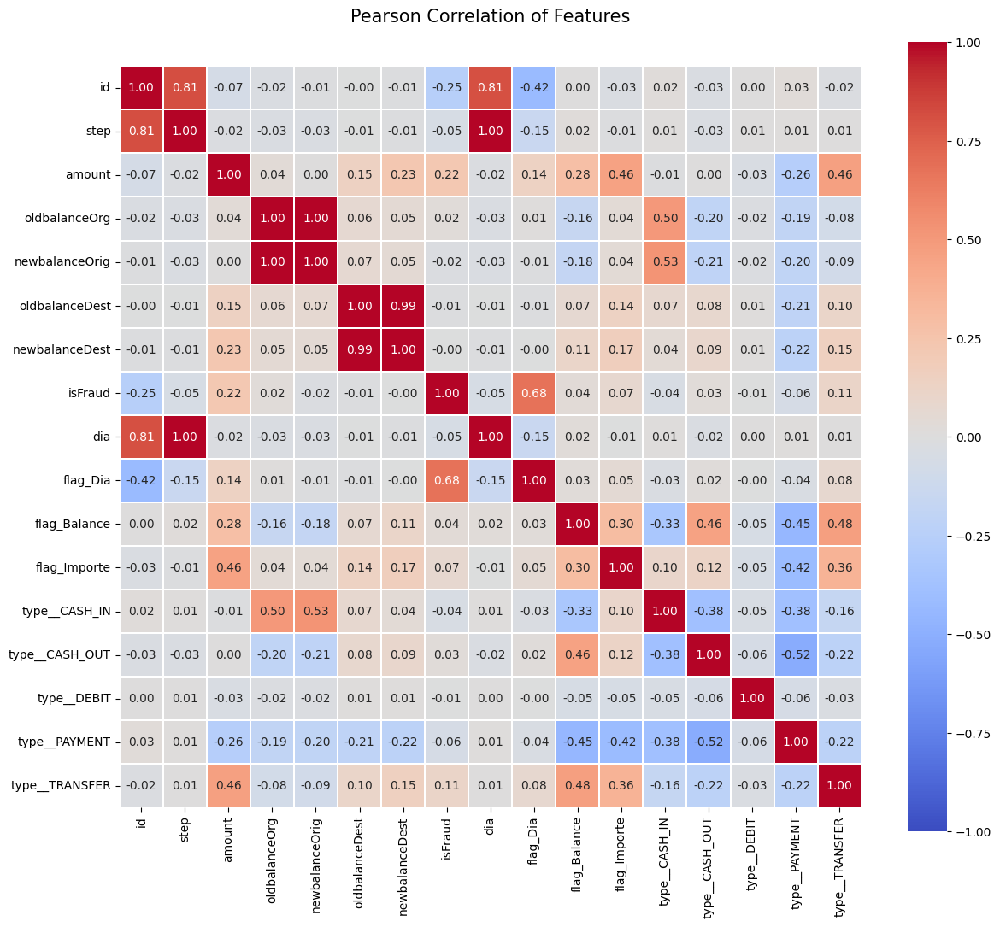

In [62]:
plt.figure(figsize=(14,12))
plt.title('Pearson Correlation of Features', y=1.05, size=15)
sns.heatmap(correlation_matrix,linewidths=0.1,vmax=1.0, vmin=-1.0,
            square=True, cmap='coolwarm',fmt = "0.2f", linecolor='white', annot=True)

Finalmente podemos observar que las siguientes variables se encuentran correlacionadas entre si:
* día y step
* amount, flag_importe y flag_balance


## <span style="color:MediumPurple" class="anchor" id="algoritmo_clasificacionn">Algoritmos de Clasificacion</span>

Sacamos las variables que no son numericas y no tienen ninguna influencia en la variable Fraude, como por ejemplo nombres de Orig y Destino ya que en nuestro análisis exploratorio demostramos no ser relevantes en la detección de transacciones fraudulentas.

Tomamos las variables que consideramos más importantes con base a nuestro análisis:
* type_TRANSFER
* amount
* Flag_Balance
* type_CASH_OUT, type_CASH_IN Y type_PAYMENT

Algunas variables que se encontraban positivamente correlacionadas con la variable fraude, también se encuentran correlacionadas con las variables elegidas, por lo que decidimos no incluirlas en el modelo para evitar overfitting.

Al mismo tiempo decidimos agregar las siguientes variables, que por mas de no estar positivamente correlacionadas, consideramos que son importantes para evitar que nuestro modelo se encuentre sesgado a encontrar solo transacciones fraudulentas:

* type_CASH_IN
* type_PAYMENT
* step

Cabe destacar que decidimos utilizar la variable step, en lugar de flag_dia (aunque flag día se encuentre altamente correlacionada con fraude, mientras que step no) ya que esta última sería buena para detectar transacciones fraudulentas realizadas antes de los 15 días, mientras que step, nos da información más generalizada.


In [63]:
df_copy = df_copy.drop(columns=['nameOrig', 'nameDest', 'id', 'flag_Dia', 'oldbalanceOrg', 'newbalanceOrig', 'nameDest', 'oldbalanceDest', 'dia'])
df_copy = df_copy.drop(columns=['newbalanceDest'])
df_copy = df_copy.drop(columns=['flag_Importe', 'type__DEBIT'])

In [64]:
df_copy.shape

(1362621, 8)

In [65]:
df_copy.head()

,step,amount,isFraud,flag_Balance,type__CASH_IN,type__CASH_OUT,type__PAYMENT,type__TRANSFER
0,353,366837.00,0,0,0,1,0,0
1,353,227225.22,0,0,0,1,0,0
2,353,92507.74,0,0,0,1,0,0
3,353,162519.57,0,0,0,1,0,0
4,353,157257.18,0,0,0,1,0,0


Finalmente quedan 7 variables correlacionadas con la variable objetivo: 'isFraud'

In [66]:
X = df_copy.drop(['isFraud'],axis=1)
y = df_copy['isFraud']
X.head()


,step,amount,flag_Balance,type__CASH_IN,type__CASH_OUT,type__PAYMENT,type__TRANSFER
0,353,366837.00,0,0,1,0,0
1,353,227225.22,0,0,1,0,0
2,353,92507.74,0,0,1,0,0
3,353,162519.57,0,0,1,0,0
4,353,157257.18,0,0,1,0,0




Entrenamos el modelo con dos datasets, Train (80%) y Test(20%)


In [67]:
X_train,X_test,y_train,y_test = train_test_split(X,y,test_size=.2,random_state= 21)

In [68]:
X_train.head()

,step,amount,flag_Balance,type__CASH_IN,type__CASH_OUT,type__PAYMENT,type__TRANSFER
205260,370,11360.28,0,0,0,1,0
666800,397,174983.20,1,0,1,0,0
668453,397,103068.52,1,0,1,0,0
474149,379,119717.40,0,1,0,0,0
292688,373,204220.69,0,1,0,0,0


In [69]:
y.head()

0    0
1    0
2    0
3    0
4    0
Name: isFraud, dtype: int64

## <span style="color:MediumPurple" class="anchor" id="modelo">Implementación del modelo: XGBoost (n=10)</span>


Modelo muestral del 15 %, no balanceado, con 7 variables correlacionadas con 'isFraude'

In [70]:
xgb = xgb.XGBClassifier(n_estimators= 10)
xgb.fit(X_train,y_train)
y_pred_xgb = xgb.predict(X_test)

print("Accuracy Score: {:0.2f}".format(accuracy_score(y_test,y_pred_xgb)))
print("Confusion Matrix: \n",confusion_matrix(y_test,y_pred_xgb))
print("Classification_Report: \n",classification_report(y_test,y_pred_xgb))

Accuracy Score: 1.00
Confusion Matrix: 
 [[270844      7]
 [   283   1391]]
Classification_Report: 
               precision    recall  f1-score   support

           0       1.00      1.00      1.00    270851
           1       0.99      0.83      0.91      1674

    accuracy                           1.00    272525
   macro avg       1.00      0.92      0.95    272525
weighted avg       1.00      1.00      1.00    272525



El modelo mejora si utilizamos un Train mayor al 70 % con la
posibilidad de sobre entrenar si es muy alto y, por lo tanto, de no adaptarse bien a nuevos datos.

El Modelo presenta, para la variable objetivo 'isFraud' = 1:

* una Precision de 0.99,
* un Recall de 0.83,
* un f1-score de 0.91

Valores más que aceptables, y reales, para un sistema de detección de fraudes en tiempo real.

El f1_score de 0.91 es muy bueno y es la métrica a utilizar en estos casos.

### Predicción <a class="anchor" id="prediccion"></a>

In [81]:
# step, amount, flag_balance, cash_in, cash_out, payment, transfer
Fraudinator = np.array([[400,100,0,0,0,0,1]])
y_pred_xgb = xgb.predict(Fraudinator)
print("Si la respuesta es 1 es Fraude!!!!!!!!")
print(y_pred_xgb)

Si la respuesta es 1 es Fraude!!!!!!!!
[0]


## <span style="color:MediumPurple"  class="anchor" id="otros">Otros algoritmos</span>

Se experimentó con los siguientes algoritmos utilizando al mismo tiempo, distintas muestras y el dataset entero (Para ver el código fuente de cada uno de estos algoritmos por favor chequee el Anexo):

* **Random Forest (criterio: Entropia)**
* **Light GMB**
* **Random Forest (criterio: Gini)**
* **Extra Tree**
* **Hist Gradient Boosting Classifier**
* **Adaboost**
* **KNN neighbord**
* **Arbol de Decisión**
* **Arbol de Decisión con criterio Gini**
* **Arbol de Decisión con criterio Entropia**
* **Todos dieron matrices de confusión o métricas peores al seleccionado**


## <span style="color:MediumPurple"  class="anchor" id="conclusion">Conclusión</span>

En conclusión, mediante el análisis exploratorio de la base de datos logramos identificar las variables más importantes para la detección de transacciones fraudulentas. Observamos patrones claros como por ejemplo:
* La cantidad de transacciones realizadas por el mismo cliente o mismo receptor, no se encuentran involucradas en transacciones fraudulentas.
* El mayor monto en las transacciones se da en transacciones del tipo Extracción y Transferencia, siendo transferencia la menos frecuente, pero ambas son el único tipo dre transaccion fraudulenta.
* Las únicas transacciones que se dan durante la primera quincena son transacciones del tipo Extracción y Transferencia, siendo estas todas transacciones fraudulentas.
* La mayor cantidad de transacciones fraudulentas aparecen a partir de los 2M.
* Aunque las transacciones fraudulentas representan solo un 0.6%, proporcionalmente corresponden a mas importe que aquellas transacciones que no son fraudulentas.

Para abordar el desafío del desequilibrio de la variable fraude, decidimos utilizar modelos de árboles de decisión, particularmente XGBoost. Este modelo es conocido por su capacidad para manejar conjuntos de datos desequilibrados y con múltiples entradas de manera eficiente. De esta manera logramos mejorar la precisión y efectividad de la detección de fraudes.



## <span style="color:MediumPurple" class="anchor" id="referencias">Referencias</span>

[1] St. Olaf College. (s.f.) Sample Size. Recuperado de https://wp.stolaf.edu/iea/sample-size/

[2] Kohli, S. (2019). Machine Learning: Target Feature Label Imbalance Problem and Solutions. Towards Data Science. Recuperado de https://towardsdatascience.com/machine-learning-target-feature-label-imbalance-problem-and-solutions-98c5ae89ad0

[3] Tianqui Chen y Carlos Guestrin. Junio 2016. XGBoost: A Scalable Tree Boosting System. https://arxiv.org/pdf/1603.02754v3.pdf